In [1]:
import os
import numpy as np

from Main import preprocess_features, preprocess_data, preprocess_data,create_estimators ,validate_estimators, get_x_y_set, get_n_best, save, load

from sys import platform, path

from DataProcessing import ModelTuning
from ModelExplainability import TabularExplainer


In [2]:
if platform == "linux" or platform == "linux2":
    path.insert(1, os.path.dirname(os.getcwd()) + "/src")
    FILE_NAME = os.path.dirname(os.getcwd()) + "/data" + "/xAPI-Edu-Data-Edited.csv"
elif platform == "win32":
    path.insert(1, os.path.dirname(os.getcwd()) + "\\src")
    FILE_NAME = os.path.dirname(os.getcwd()) + "\\data" + "\\xAPI-Edu-Data-Edited.csv"
elif platform == "darwin":
    path.insert(1, os.path.dirname(os.getcwd()) + "/src")
    FILE_NAME = os.path.dirname(os.getcwd()) + "/data" + "/xAPI-Edu-Data-Edited.csv"
    
CATEGORICAL_COLUMNS = ["Gender", "Nationality", "PlaceofBirth", "StageID", "GradeID", "SectionID", "Topic",
                       "Semester", "Relation", "ParentAnsweringSurvey", "ParentSchoolSatisfaction",
                       "StudentAbsenceDays"]

PREFIXES = ["Gender", "Nationality", "PlaceofBirth", "Stage", "Grade", "Section", "Topic",
            "Semester", "Relation", "Survey", "ParentSatisfaction",
            "Absence"]

LABELS = ["H","L","M"]

## Data Pre-processing

In this step scaling and PCA are applied to the dataset, the number of componets used are those that represent 85% of the variance.

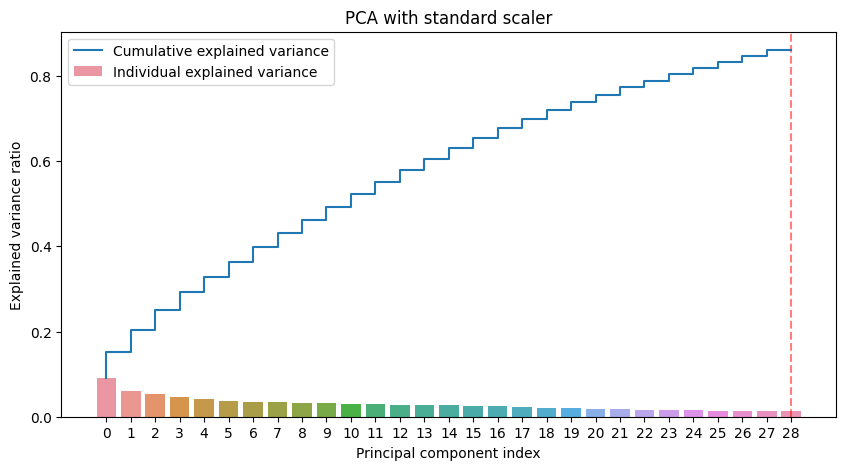

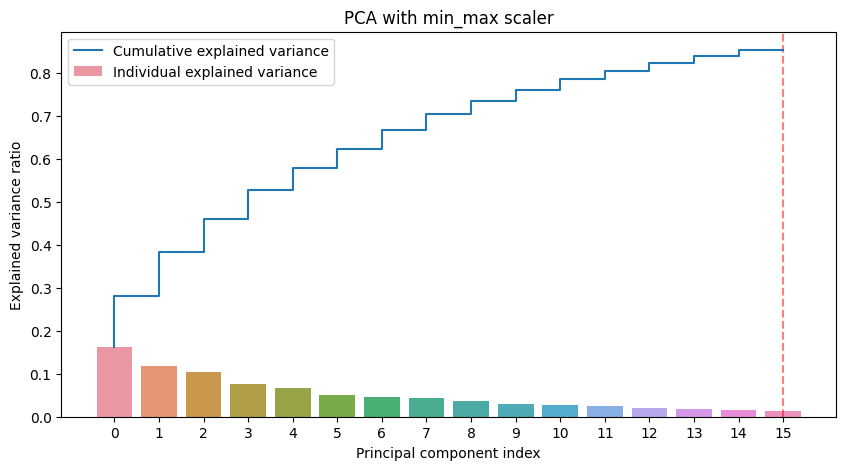

In [3]:
 # Preprocess Data

X_data, y_data, y_labels = preprocess_data(replace_values=False)

X_data_std, pipeline_std = preprocess_features(X_data, scaler_type="standard", plot_pca=True, n_components=29)
X_data_min, pipeline_min = preprocess_features(X_data, scaler_type="min_max", plot_pca=True, n_components=16)

## Data Processing

This is the step where the classifiers are trained, 9 classifiers are trained for each scaling method.


In [4]:
# Create std estimators

std_estimators, mt_std = create_estimators(X_data_std, y_data, random_state=42)

Creating Basic Estimators...



[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:    2.9s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:    0.0s finished


avg. DecisionTreeClassifier(random_state=42) scores:
accuracy: 0.6072431957857769
precision: 0.62412871142972
recall: 0.6067808437263416
f1 score: 0.6129857609749735

avg. SVC(probability=True, random_state=42) scores:
accuracy: 0.6787532923617208
precision: 0.7099060694494133
recall: 0.6837424679562434
f1 score: 0.6929726628481032



[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:    0.7s finished


avg. RandomForestClassifier(random_state=42) scores:
accuracy: 0.6755487269534679
precision: 0.7053840153210971
recall: 0.6638451782512106
f1 score: 0.6764813896054125

Tunning Hyperparams...

Fitting 5 folds for each of 5 candidates, totalling 25 fits
Best DecisionTreeClassifier estimator:
accuracy: 0.5001904761904761
precision: 0.477044326044326
recall: 0.4908253968253968
F1 Score: 0.610993265993266

Fitting 5 folds for each of 5 candidates, totalling 25 fits
Best SVC estimator:
accuracy: 0.5674285714285714
precision: 0.5631428571428572
recall: 0.5498095238095237
F1 Score: 0.625938135938136

Fitting 5 folds for each of 5 candidates, totalling 25 fits
Best RandomForestClassifier estimator:
accuracy: 0.5849523809523809
precision: 0.6286671476671476
recall: 0.546888888888889
F1 Score: 0.574094424094424

Boosting...

Boosted dt:
Fitting 5 folds for each of 5 candidates, totalling 25 fits
Best Adaboost estimator:
AdaBoostClassifier(base_estimator=DecisionTreeClassifier(max_depth=5,
      

In [5]:
# Create min_max estimators

min_estimators, mt_min = create_estimators(X_data_min, y_data, random_state=42)

Creating Basic Estimators...

avg. DecisionTreeClassifier(random_state=42) scores:
accuracy: 0.6011852502194908
precision: 0.6134266720933388
recall: 0.6175906508166848
f1 score: 0.6098590951512424



[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:    0.0s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:    0.1s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.


avg. SVC(probability=True, random_state=42) scores:
accuracy: 0.7291483757682178
precision: 0.7461265953950031
recall: 0.7347842073997379
f1 score: 0.7373350724056982



[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:    0.6s finished


avg. RandomForestClassifier(random_state=42) scores:
accuracy: 0.6696663740122915
precision: 0.6877897095622443
recall: 0.6734115323927036
f1 score: 0.6777238754586266

Tunning Hyperparams...

Fitting 5 folds for each of 5 candidates, totalling 25 fits
Best DecisionTreeClassifier estimator:
accuracy: 0.5186666666666667
precision: 0.4865583675583676
recall: 0.5221269841269842
F1 Score: 0.5907115107115106

Fitting 5 folds for each of 5 candidates, totalling 25 fits
Best SVC estimator:
accuracy: 0.5899047619047619
precision: 0.47136507936507926
recall: 0.5369206349206349
F1 Score: 0.6660869631457867

Fitting 5 folds for each of 5 candidates, totalling 25 fits
Best RandomForestClassifier estimator:
accuracy: 0.5340952380952381
precision: 0.5468075998075999
recall: 0.5149841269841271
F1 Score: 0.5248462648462648

Boosting...

Boosted dt:
Fitting 5 folds for each of 5 candidates, totalling 25 fits
Best Adaboost estimator:
AdaBoostClassifier(base_estimator=DecisionTreeClassifier(max_depth=2,


## Model Validation

In this step the top 2 classifiers are selected and validated using different scores and the confusion matrix.

In [6]:
# Validate estimators

# get val set
X_test_std, y_test_std = get_x_y_set(mt_std)
X_test_min, y_test_min = get_x_y_set(mt_min)

In [7]:
# Show best std

best_std = get_n_best(std_estimators, X_test_std, y_test_std, y_labels, best_n=2)
print("Best Standard_scaled est:", best_std)

Best Standard_scaled est: [AdaBoostClassifier(base_estimator=SVC(C=100, gamma=0.0001, probability=True,
                                      random_state=42),
                   learning_rate=0.1, n_estimators=10, random_state=42), RandomForestClassifier(random_state=42)]


In [8]:
# Show best min_max

best_min = get_n_best(min_estimators, X_test_min, y_test_min, y_labels, best_n=2)
print("Best Min_´Max_scaled est:", best_min)

Best Min_´Max_scaled est: [SVC(probability=True, random_state=42), AdaBoostClassifier(base_estimator=SVC(C=100, kernel='linear', probability=True,
                                      random_state=42),
                   learning_rate=0.0001, n_estimators=1, random_state=42)]


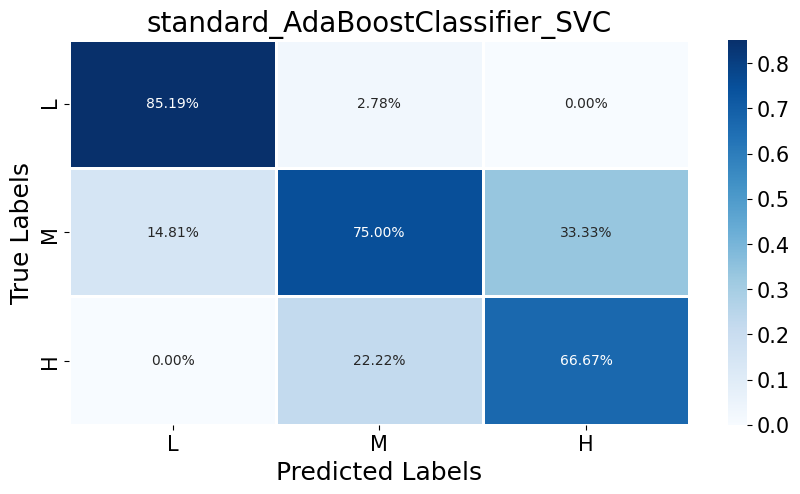

Classification Report: AdaBoostClassifier(base_estimator=SVC(C=100, gamma=0.0001, probability=True,
                                      random_state=42),
                   learning_rate=0.1, n_estimators=10, random_state=42)
              precision    recall  f1-score   support

           H       0.67      0.43      0.52        14
           L       0.85      0.96      0.90        24
           M       0.75      0.79      0.77        34

    accuracy                           0.78        72
   macro avg       0.76      0.73      0.73        72
weighted avg       0.77      0.78      0.77        72



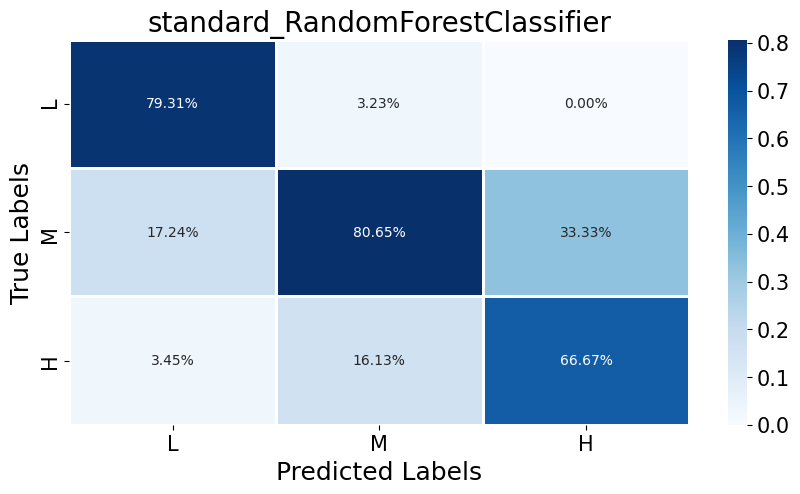

Classification Report: RandomForestClassifier(random_state=42)
              precision    recall  f1-score   support

           H       0.67      0.57      0.62        14
           L       0.79      0.96      0.87        24
           M       0.81      0.74      0.77        34

    accuracy                           0.78        72
   macro avg       0.76      0.76      0.75        72
weighted avg       0.77      0.78      0.77        72



In [9]:
# Compute scores for std classifiers

validate_estimators(best_std, X_test_std, y_test_std, y_labels,clas_report=True, scaler_type="standard")

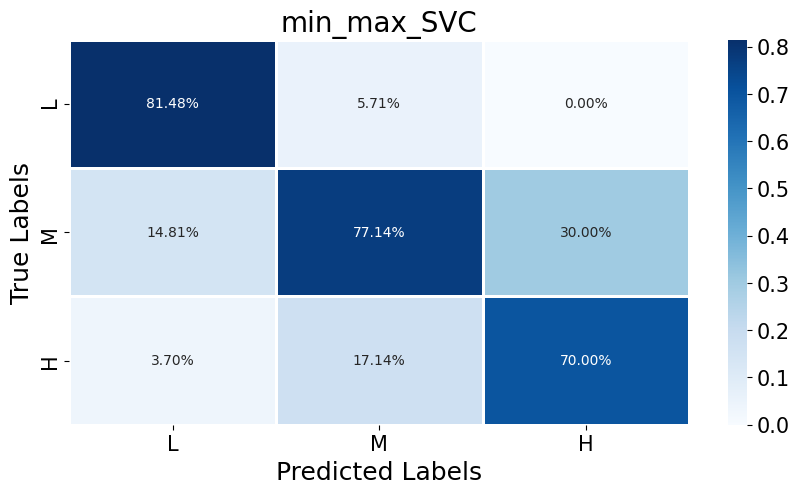

Classification Report: SVC(probability=True, random_state=42)
              precision    recall  f1-score   support

           H       0.70      0.50      0.58        14
           L       0.81      0.92      0.86        24
           M       0.77      0.79      0.78        34

    accuracy                           0.78        72
   macro avg       0.76      0.74      0.74        72
weighted avg       0.77      0.78      0.77        72



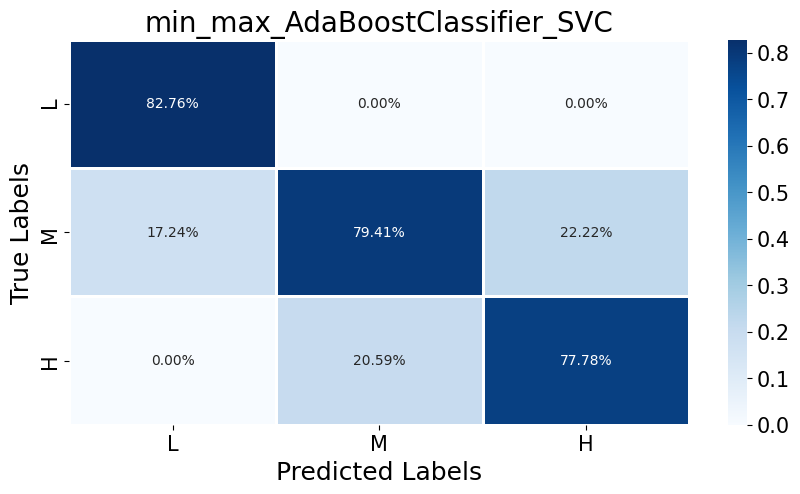

Classification Report: AdaBoostClassifier(base_estimator=SVC(C=100, kernel='linear', probability=True,
                                      random_state=42),
                   learning_rate=0.0001, n_estimators=1, random_state=42)
              precision    recall  f1-score   support

           H       0.78      0.50      0.61        14
           L       0.83      1.00      0.91        24
           M       0.79      0.79      0.79        34

    accuracy                           0.81        72
   macro avg       0.80      0.76      0.77        72
weighted avg       0.80      0.81      0.80        72



In [10]:
# Compute scores for min_max classifiers

validate_estimators(best_min, X_test_min, y_test_min, y_labels,clas_report=True, scaler_type="min_max")

The models can be saved as a pickle file, with their respective pipeline. For later use.

In [11]:
# Save Models

save(best_std, suffix="std")
save(best_min, suffix="min_max")

File Saved as: AdaBoostClassifier_SVC_std
File Saved as: RandomForestClassifier_std
File Saved as: SVC_min_max
File Saved as: AdaBoostClassifier_SVC_min_max


In [12]:
# Save Pipelines

save(pipeline_std, file_name="pipeline_std")
save(pipeline_min, file_name="pipeline_min")

File Saved as: pipeline_std
File Saved as: pipeline_min


In [13]:
# Load standard models

rf_std = load("RandomForestClassifier_std")
ada_svc_std = load("AdaBoostClassifier_SVC_std")

# Load std Pipeline
pipeline_std = load("pipeline_std")

best_std = [rf_std, ada_svc_std]

Model Loaded: RandomForestClassifier_std
Model Loaded: AdaBoostClassifier_SVC_std
Model Loaded: pipeline_std


In [14]:
# Load min_max models

ada_svc_min = load("AdaBoostClassifier_SVC_min_max")
svc_min = load("SVC_min_max")

# Load min_max Pipeline
pipeline_min = load("pipeline_min")

best_min = [ada_svc_min, svc_min]

Model Loaded: AdaBoostClassifier_SVC_min_max
Model Loaded: SVC_min_max
Model Loaded: pipeline_min


## Model Explainability

With thew help of LIME, the models decision-making process can be explained.

In [15]:
# Split raw data
X_data, y_data, y_labels = preprocess_data(replace_values=False)

mt = ModelTuning(X_data, y_data, train_size=0.7, random_state=42)
X_test, y_test = get_x_y_set(mt)
X_train, y_train = get_x_y_set(mt, type="train")

In [16]:
# Select instances to be explained

print(f"True Class: {LABELS[y_test[0]]}")
print(f"True Class: {LABELS[y_test[1]]}")
print(f"True Class: {LABELS[y_test[18]]}")

True Class: L
True Class: M
True Class: H


In [17]:
# Create explainer for standard

exp = TabularExplainer(best_std, pipeline_std, X_train, y_train, X_test, LABELS)

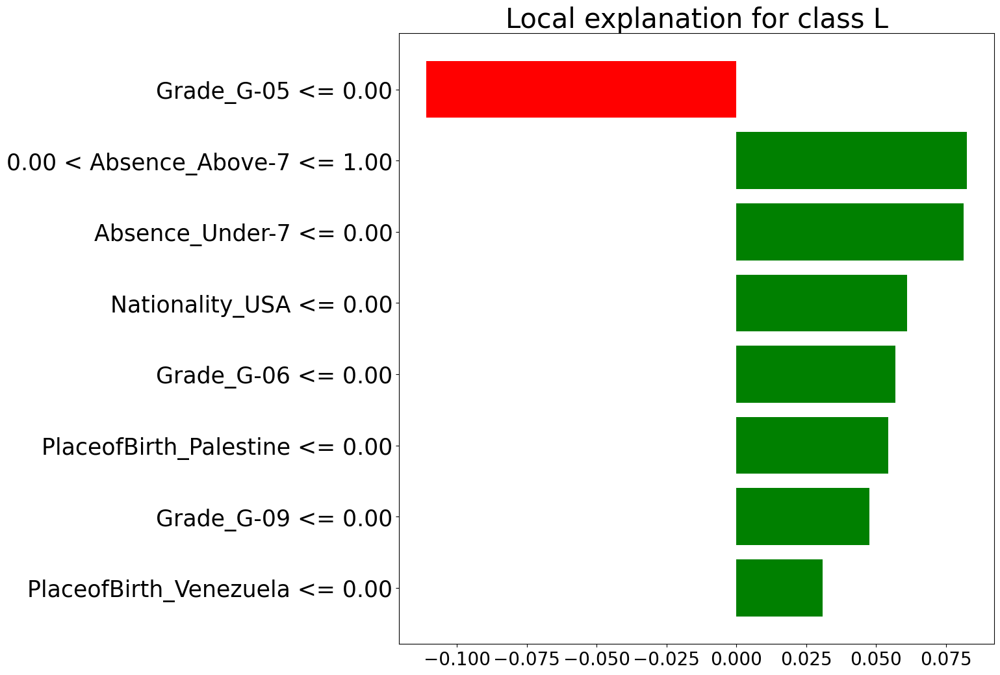

In [18]:
# Explain the three instances with of two models

exp.explain_lime(clf_index=0, data_index=0)

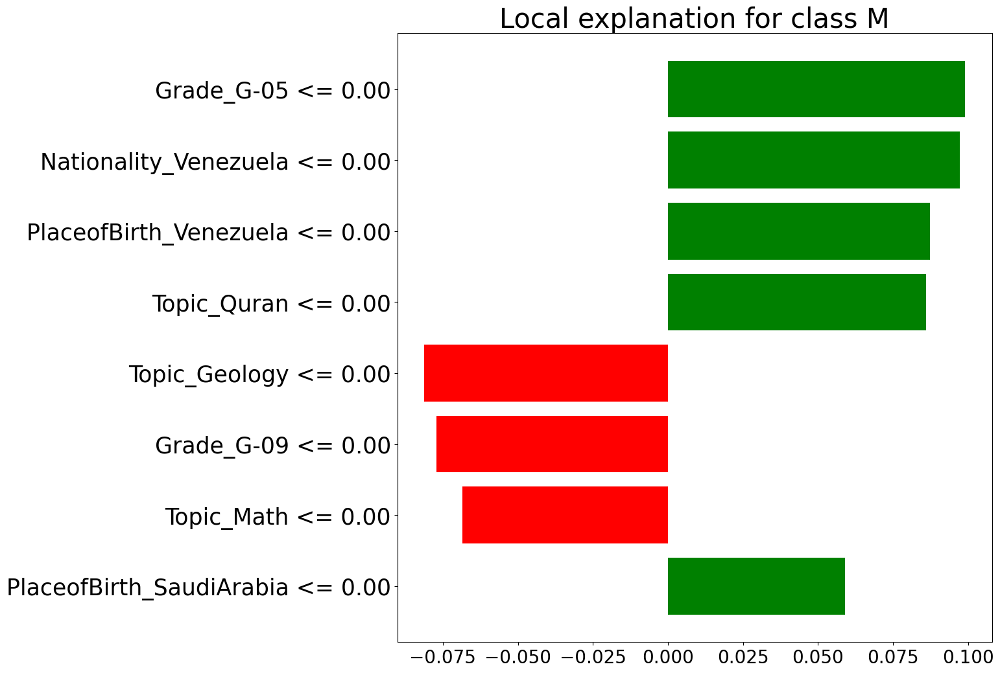

In [19]:
exp.explain_lime(clf_index=0, data_index=1)

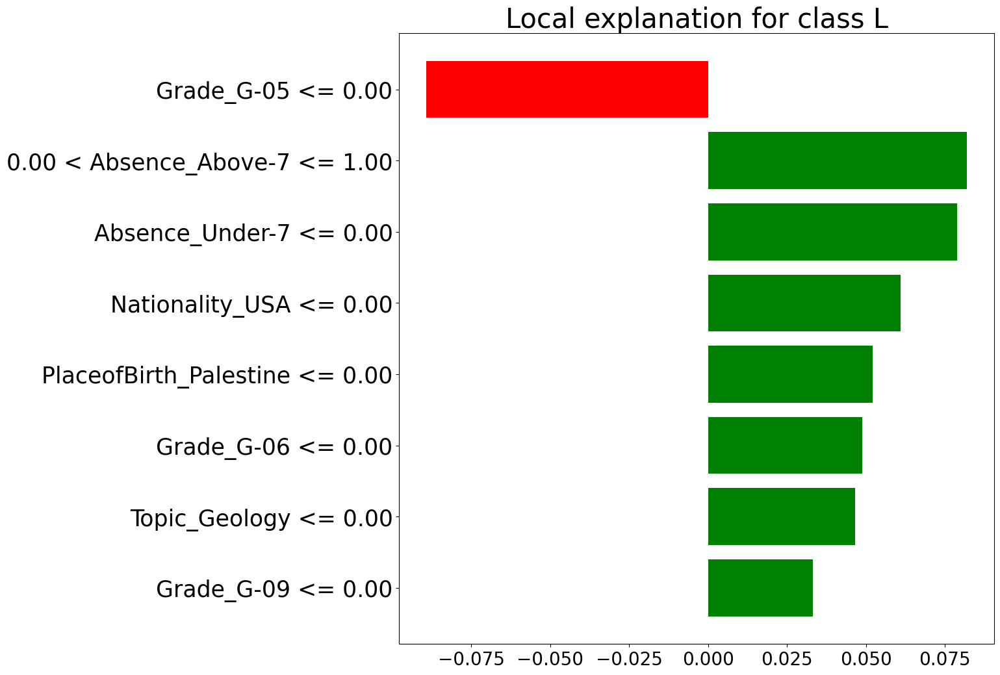

In [20]:
exp.explain_lime(clf_index=0, data_index=18)

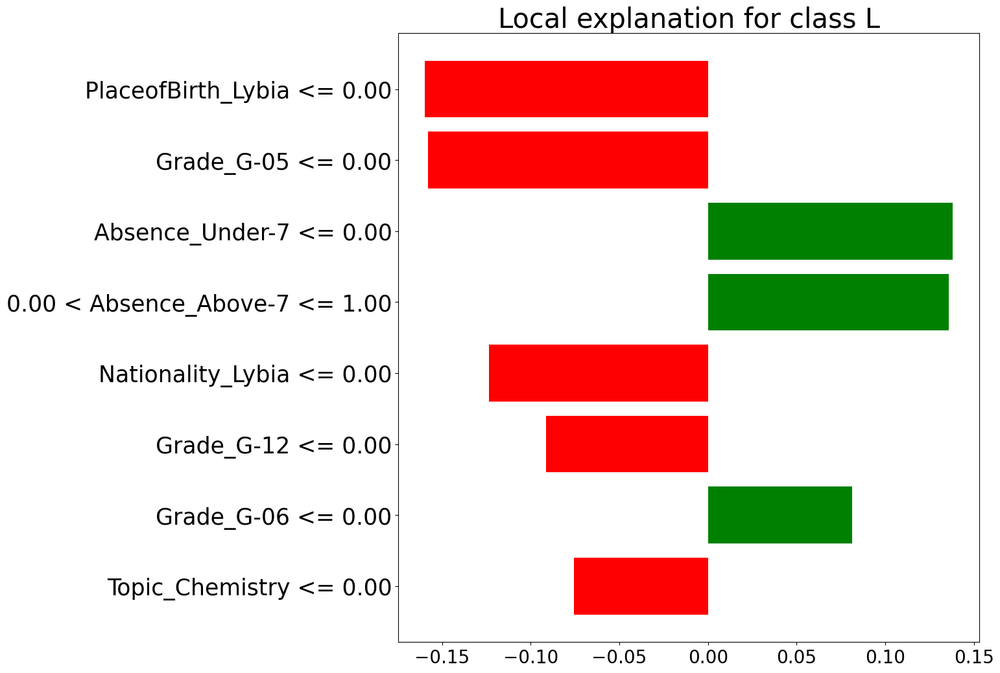

In [21]:
exp.explain_lime(clf_index=1, data_index=0)

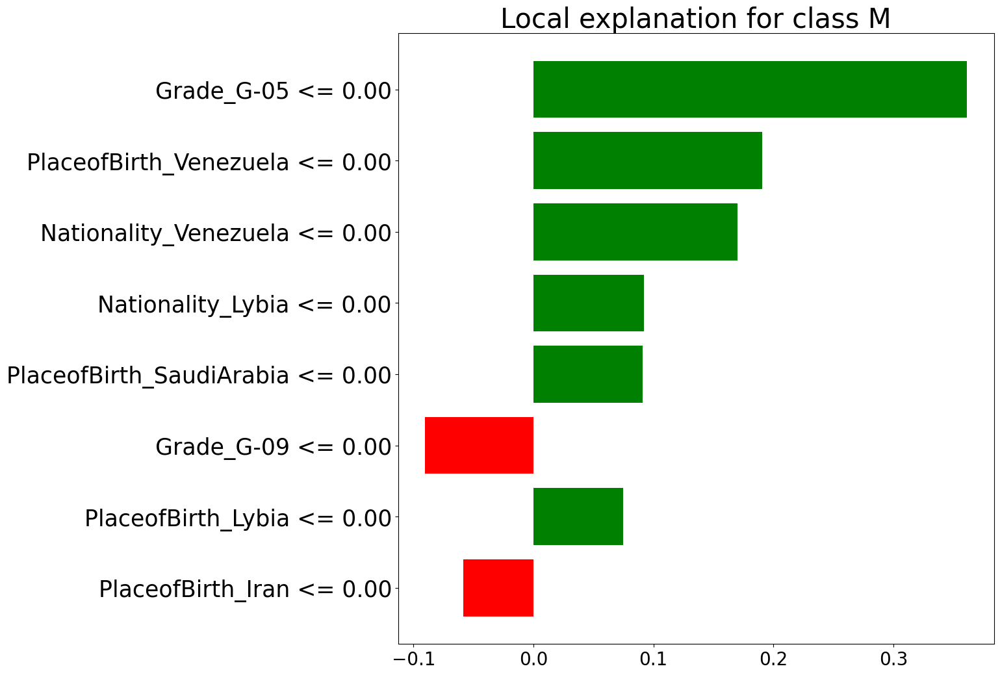

In [22]:
exp.explain_lime(clf_index=1, data_index=1)

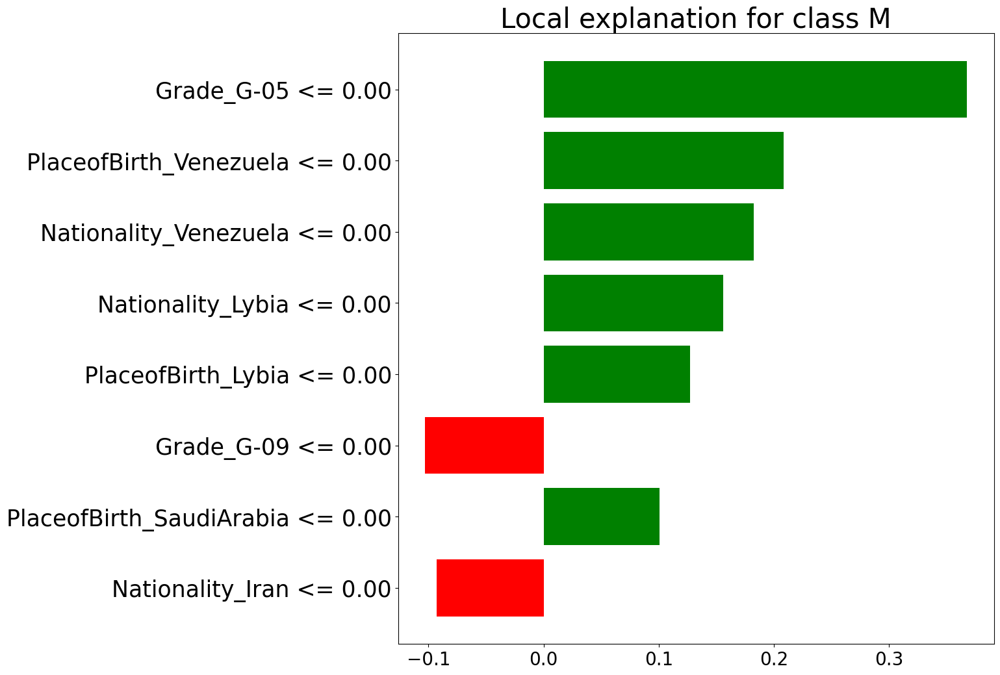

In [23]:
exp.explain_lime(clf_index=1, data_index=18)

  0%|          | 0/72 [00:00<?, ?it/s]

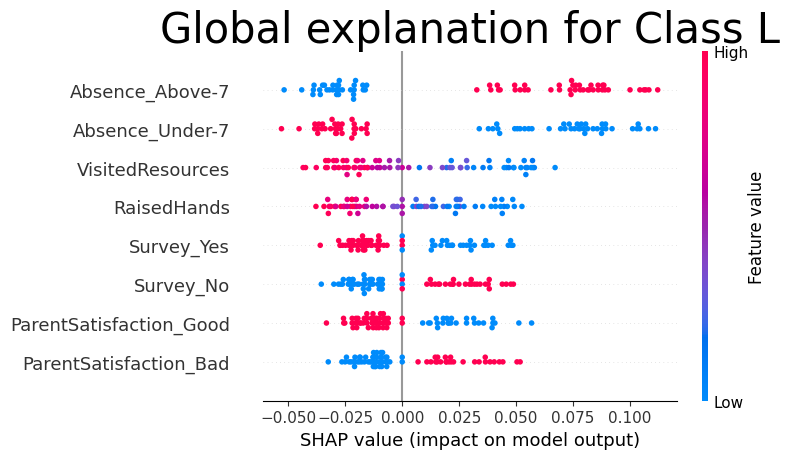

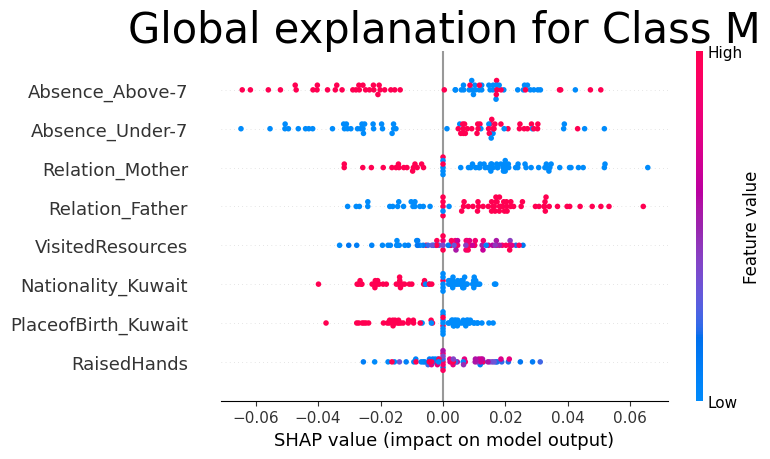

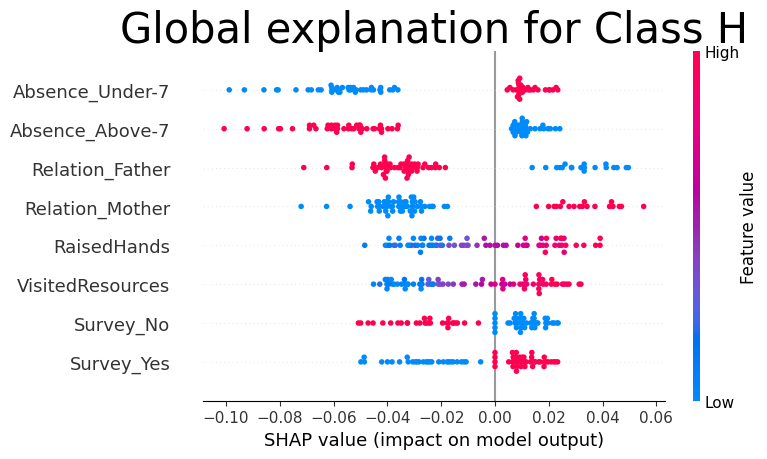

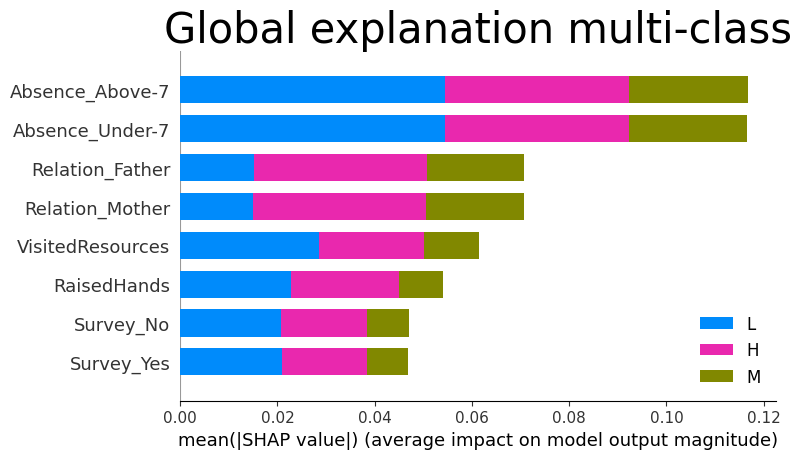

In [24]:
exp.explain_shap(clf_index=0, n_samples=50)

  0%|          | 0/72 [00:00<?, ?it/s]

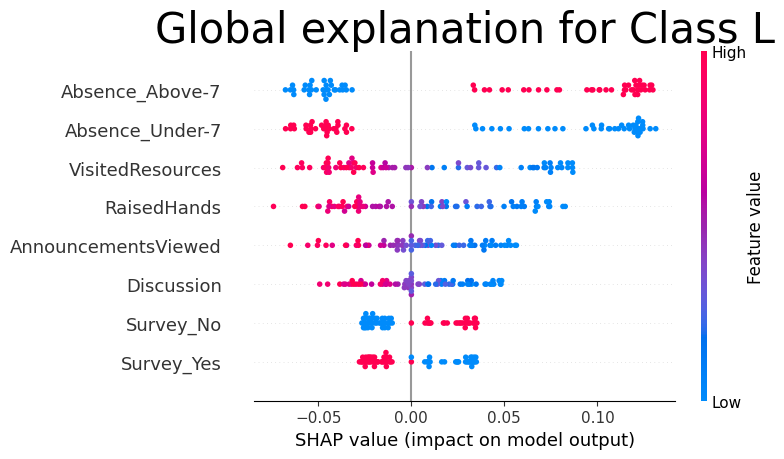

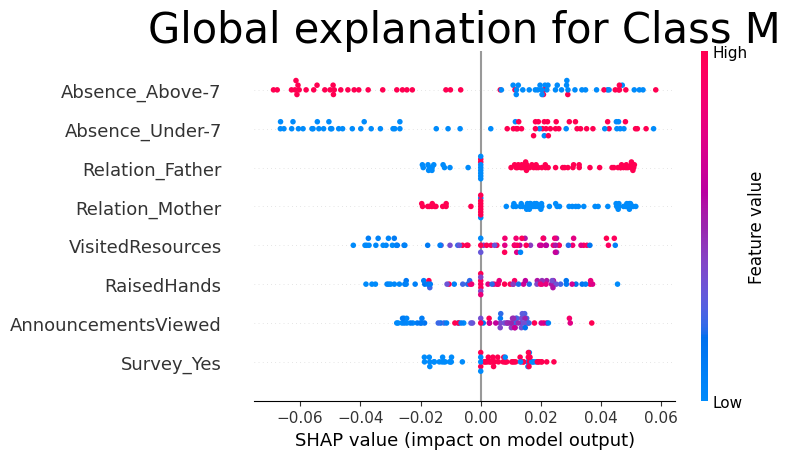

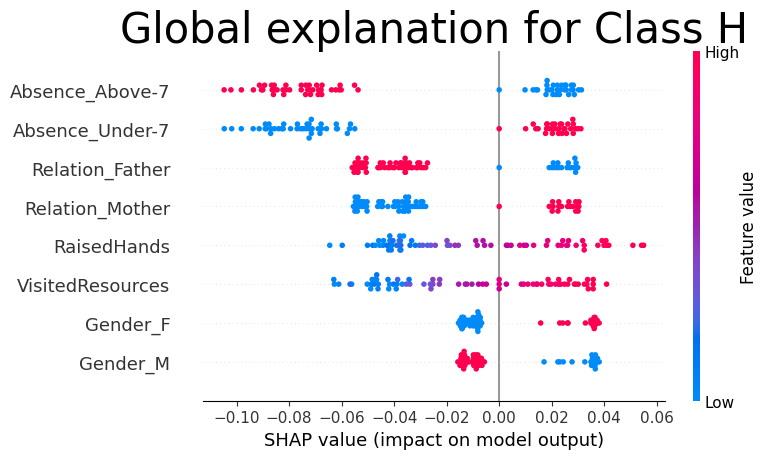

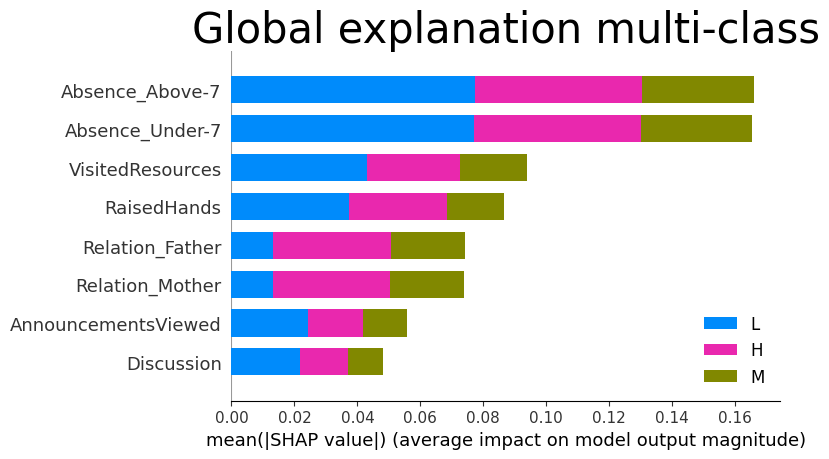

In [25]:
exp.explain_shap(clf_index=1, n_samples=45)

In [26]:
# Create explainer for min_max

exp = TabularExplainer(best_min, pipeline_min, X_train, y_train, X_test, LABELS)

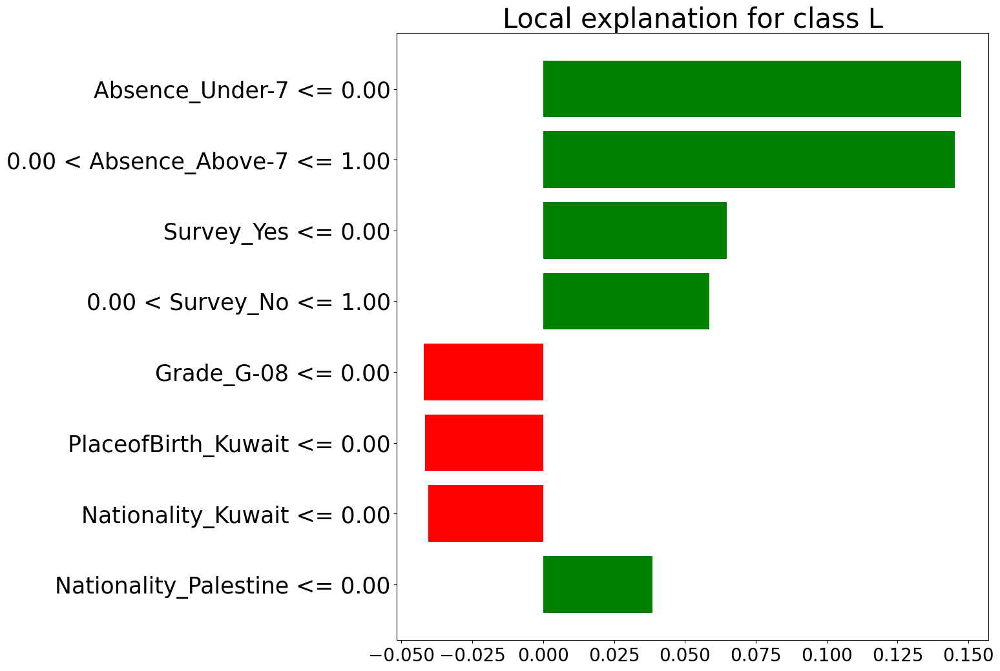

In [27]:
exp.explain_lime(clf_index=0, data_index=0)

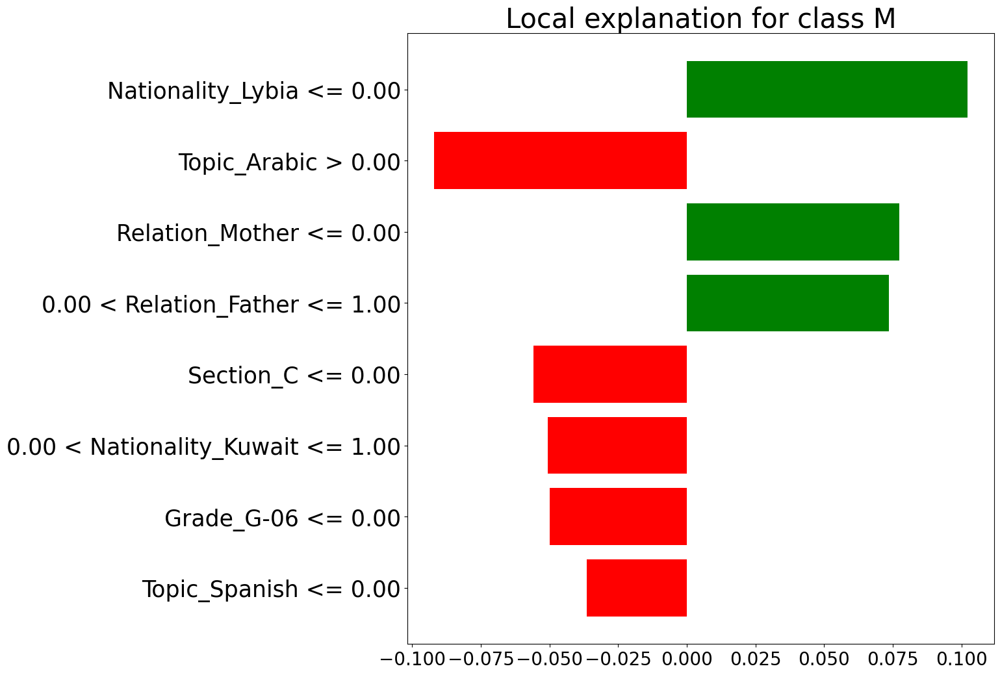

In [28]:
exp.explain_lime(clf_index=0, data_index=1)

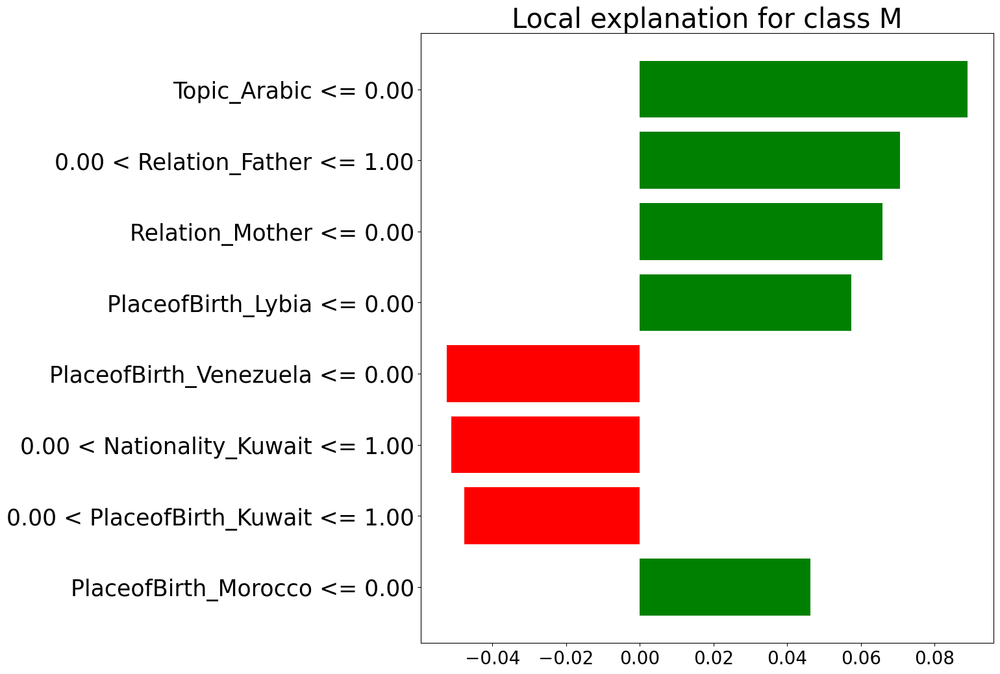

In [29]:
exp.explain_lime(clf_index=0, data_index=18)

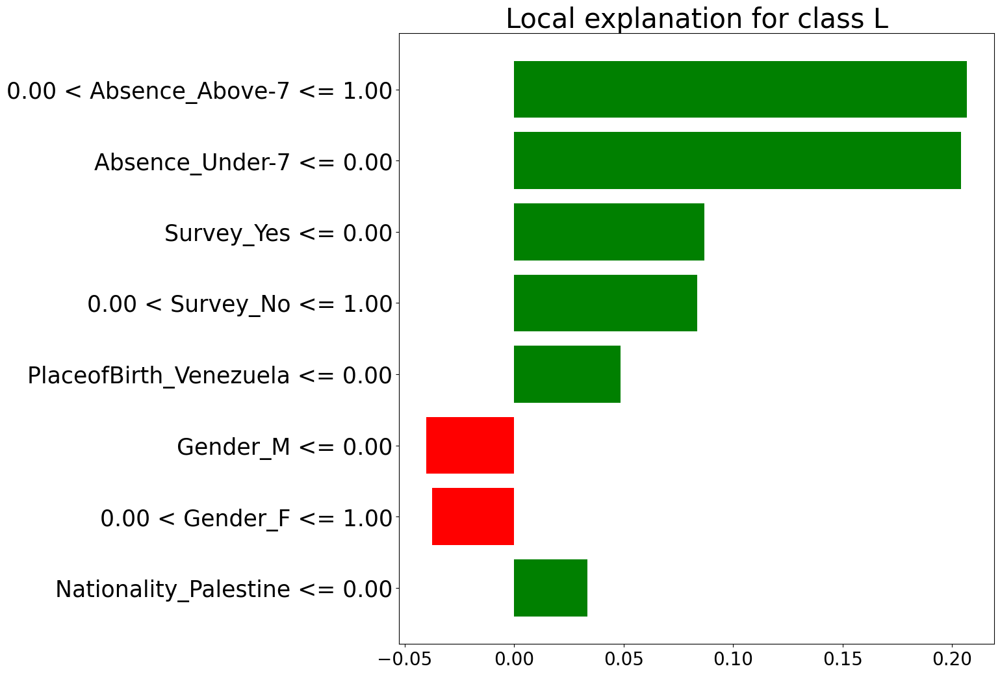

In [30]:
exp.explain_lime(clf_index=1, data_index=0)

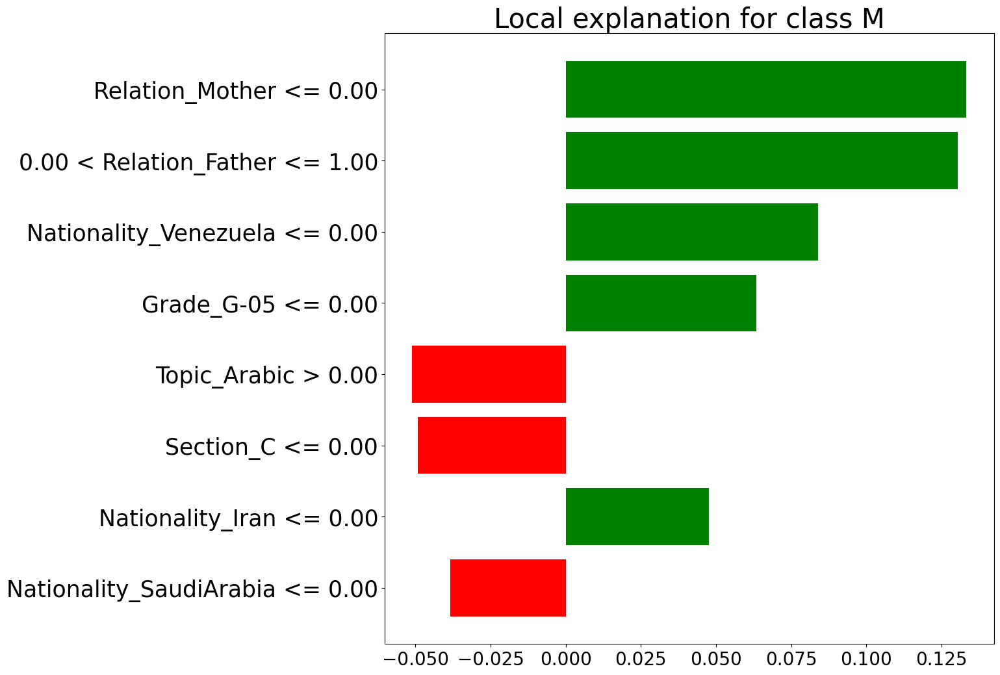

In [31]:
exp.explain_lime(clf_index=1, data_index=1)

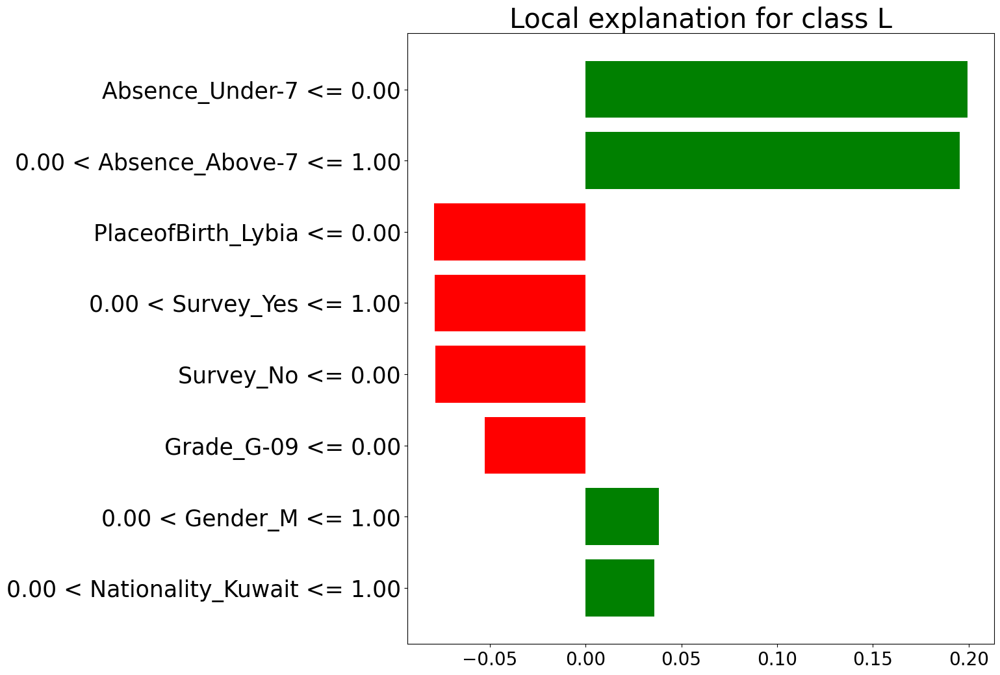

In [32]:
exp.explain_lime(clf_index=1, data_index=18)

## Improving The Model

After removing some biased values and thee model can be retrained.

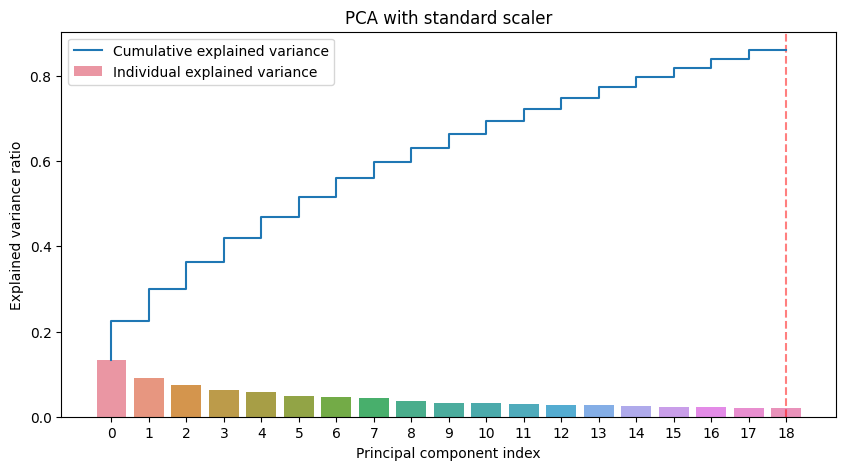

In [33]:
 # Preprocess Data

X_data, y_data, y_labels = preprocess_data(replace_values=True,remove_values=True)

X_data_std, pipeline_std = preprocess_features(X_data, scaler_type="standard", plot_pca=True, n_components=19)

In [34]:
std_estimators, mt_std = create_estimators(X_data_std, y_data, random_state=0)

Creating Basic Estimators...



[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:    3.5s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:    0.0s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.


avg. DecisionTreeClassifier(random_state=0) scores:
accuracy: 0.6151515151515151
precision: 0.6237059872419948
recall: 0.6259321675837102
f1 score: 0.6198464554577948

avg. SVC(probability=True, random_state=0) scores:
accuracy: 0.7303030303030302
precision: 0.7551624778075393
recall: 0.7272943853887592
f1 score: 0.7327043516570001



[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:    0.6s finished


avg. RandomForestClassifier(random_state=0) scores:
accuracy: 0.693939393939394
precision: 0.7156458021392736
recall: 0.6915354478149396
f1 score: 0.6936189406277178

Tunning Hyperparams...

Fitting 5 folds for each of 5 candidates, totalling 25 fits
Best DecisionTreeClassifier estimator:
accuracy: 0.35180952380952385
precision: 0.3234790764790765
recall: 0.33777777777777784
F1 Score: 0.3529432315190829

Fitting 5 folds for each of 5 candidates, totalling 25 fits
Best SVC estimator:
accuracy: 0.5260952380952381
precision: 0.5108706108706109
recall: 0.5162698412698413
F1 Score: 0.5277352277352276

Fitting 5 folds for each of 5 candidates, totalling 25 fits
Best RandomForestClassifier estimator:
accuracy: 0.5367619047619048
precision: 0.4559663299663299
recall: 0.45849206349206345
F1 Score: 0.472955758962624

Boosting...

Boosted dt:
Fitting 5 folds for each of 5 candidates, totalling 25 fits
Best Adaboost estimator:
AdaBoostClassifier(base_estimator=DecisionTreeClassifier(max_depth=3,
 

In [35]:
# Validate estimators

# get test set
X_test_std, y_test_std = get_x_y_set(mt_std)

In [36]:
# Show best std
best_std = get_n_best(std_estimators, X_test_std, y_test_std, y_labels, best_n=1)
print("Best Standard_scaled est:", best_std)

Best Standard_scaled est: [AdaBoostClassifier(base_estimator=SVC(C=1000, gamma=0.001, probability=True,
                                      random_state=0),
                   learning_rate=0.1, n_estimators=10, random_state=0)]


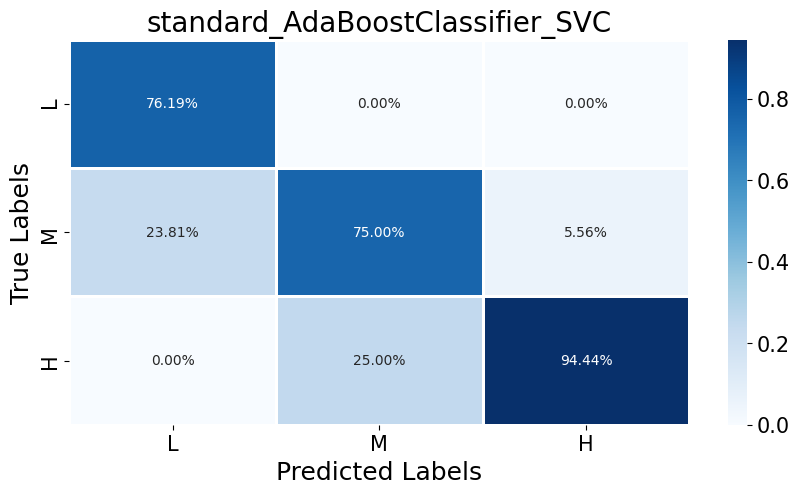

Classification Report: AdaBoostClassifier(base_estimator=SVC(C=1000, gamma=0.001, probability=True,
                                      random_state=0),
                   learning_rate=0.1, n_estimators=10, random_state=0)
              precision    recall  f1-score   support

           H       0.94      0.68      0.79        25
           L       0.76      1.00      0.86        16
           M       0.75      0.80      0.77        30

    accuracy                           0.80        71
   macro avg       0.82      0.83      0.81        71
weighted avg       0.82      0.80      0.80        71



In [37]:
validate_estimators(best_std, X_test_std, y_test_std, y_labels,clas_report=True, scaler_type="standard")

In [38]:
# Load Model

# final = load("AdaBoostClassifier_SVC_std_final")

# best_std = [final]

# # Load Pipeline
# pipeline_std = load("pipeline_std_final")


In [39]:
# Split raw data
X_data, y_data, y_labels = preprocess_data(replace_values=True, remove_values=True)

mt = ModelTuning(X_data, y_data, train_size=0.7, random_state=0)
X_test, y_test = get_x_y_set(mt)
X_train, y_train = get_x_y_set(mt, type="train")

In [40]:
print(f"True Class: {LABELS[y_test[3]]}")
print(f"True Class: {LABELS[y_test[0]]}")
print(f"True Class: {LABELS[y_test[11]]}")

True Class: L
True Class: M
True Class: H


In [41]:
# Create explainer for standard
exp = TabularExplainer(best_std, pipeline_std, X_train, y_train, X_test, LABELS)

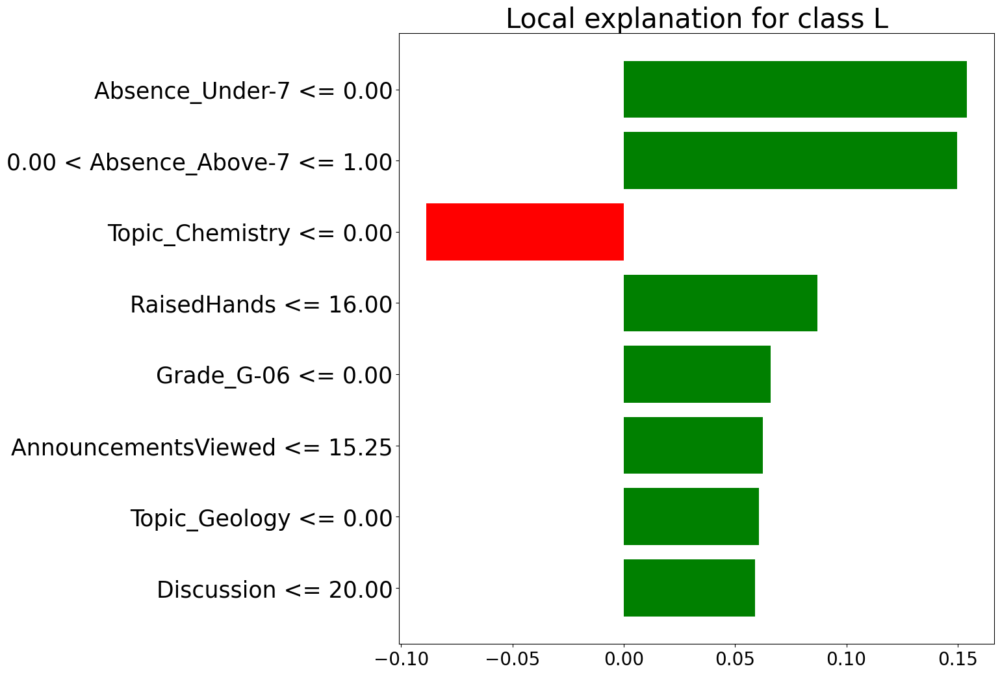

In [42]:
exp.explain_lime(clf_index=0, data_index=3, suffix="_Final")

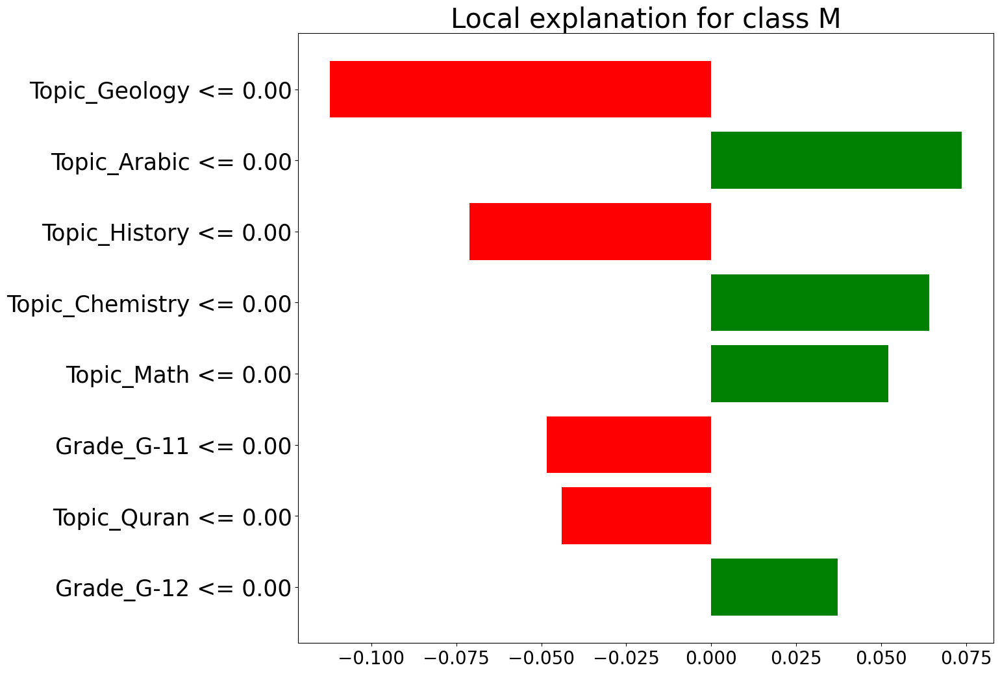

In [43]:
exp.explain_lime(clf_index=0, data_index=0, suffix="_Final")

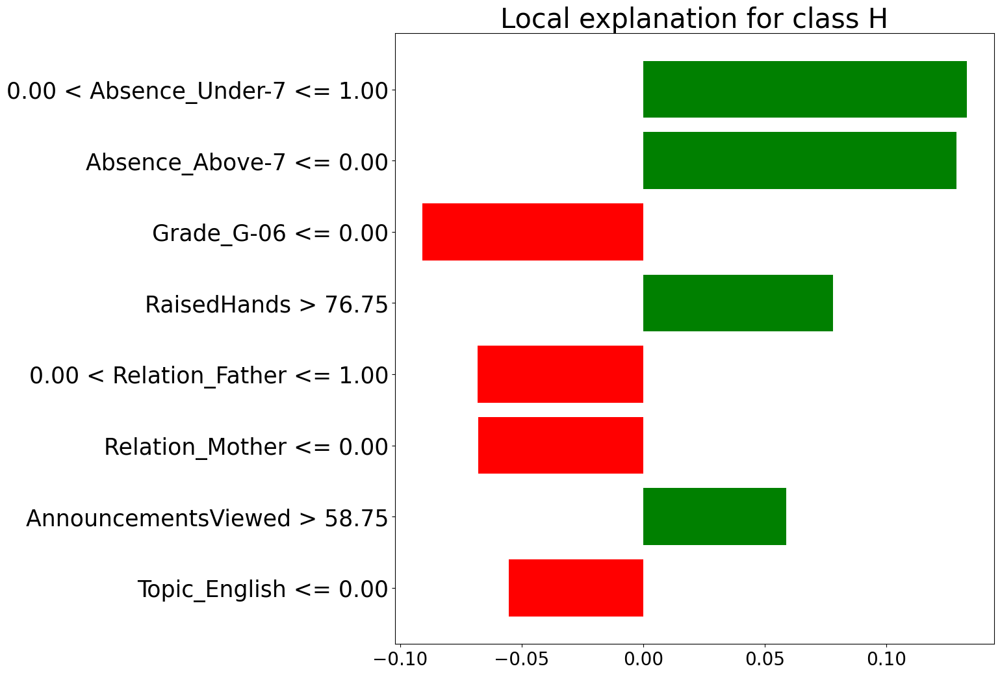

In [44]:
exp.explain_lime(clf_index=0, data_index=11, suffix="_Final")

  0%|          | 0/71 [00:00<?, ?it/s]

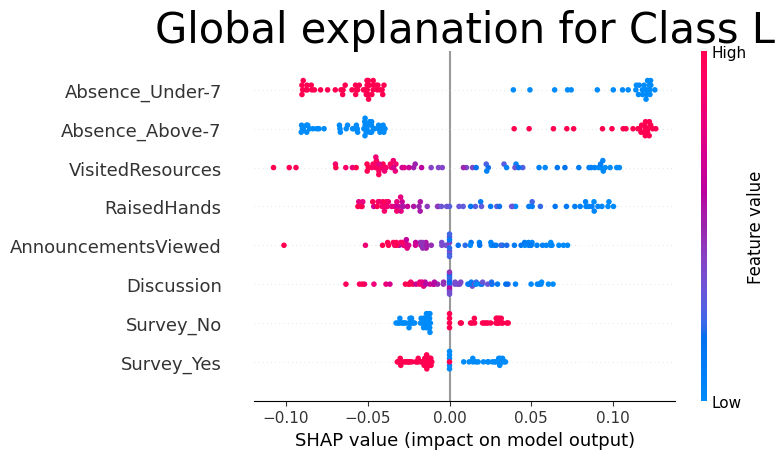

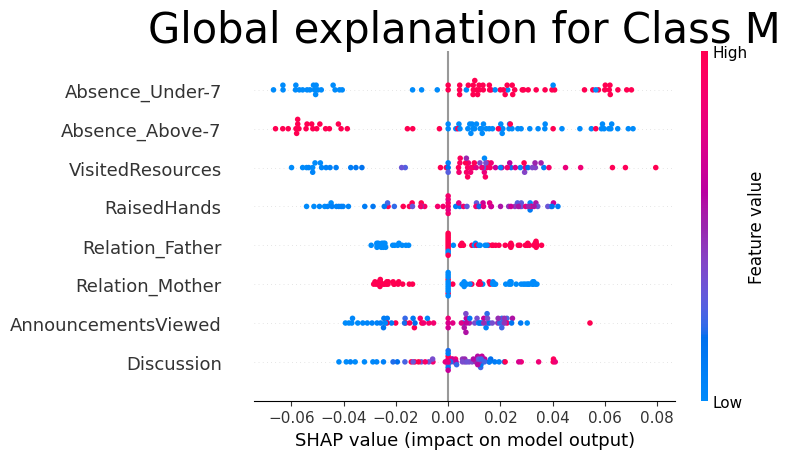

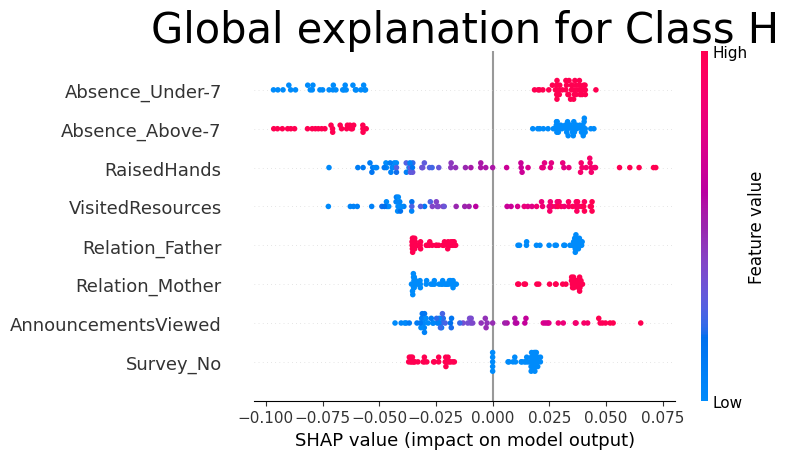

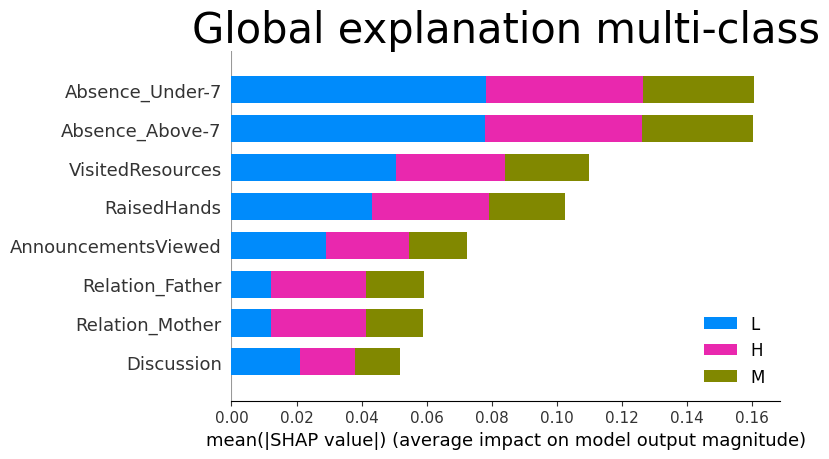

In [45]:
exp.explain_shap(clf_index=0, n_samples=50, suffix="_Final")

In [46]:
# Save Model

save(best_std, suffix="std_final")

# Save Pipeline

save(pipeline_std, file_name="pipeline_std_final")

File Saved as: AdaBoostClassifier_SVC_std_final
File Saved as: pipeline_std_final
